# Computes and plots the urban wind for the previous 24hours 
# Use polytope kernel


In [1]:
#output_1 = cap.stdout.split('}\n')
#access_token = output_1[-1][0:-1]
#import earthkit.plots
from polytope.api import Client
import numpy as np
import pandas as pd
from src.urban_wind import get_wind_extreme_dt, read_cfd_wind, scale_cfd_wind, save_local_wind
from src.green_pont import load_json_with_comments
from src.plots_jupyter import wind_animation
from IPython.display import HTML

import matplotlib.pyplot as plt

LIVE_REQUEST = True

cf=load_json_with_comments('etc/settings_wind_maps.json')
path_cfd=cf['path_cfd'] 
angles=cf["angles"]
height=cf["height"]


In [2]:
LOCATION = ((51.213642, 4.415)) #  center of antwerp to get meteo data from ecmwf
wind_meteo=get_wind_extreme_dt(LOCATION,date='-1')
print(wind_meteo)

2025-10-28 12:35:17 - INFO - Key read from /home/jovyan/.polytopeapirc
2025-10-28 12:35:17 - INFO - Sending request...
{'request': 'class: d1\n'
            'dataset: extremes-dt\n'
            "date: '-1'\n"
            "expver: '0001'\n"
            'feature:\n'
            '  axes: step\n'
            '  points:\n'
            '  - - 51.213642\n'
            '    - 4.415\n'
            '  range:\n'
            '    end: 24\n'
            '    start: 0\n'
            '  type: timeseries\n'
            'levtype: sfc\n'
            'param: 166/165\n'
            'stream: oper\n'
            "time: '0000'\n"
            'type: fc\n',
 'verb': 'retrieve'}
2025-10-28 12:35:17 - INFO - Polytope user key found in session cache for user jovyan
2025-10-28 12:35:19 - INFO - Request accepted. Please poll ./0118c90a-9b5b-4561-9b9a-c0daba6f748a for status
2025-10-28 12:35:19 - INFO - Polytope user key found in session cache for user jovyan
2025-10-28 12:35:19 - INFO - Checking request status (011

                     wind_speed    wind_dir
2025-10-27 00:00:00    7.690690  233.518205
2025-10-27 01:00:00    8.785993  246.172114
2025-10-27 02:00:00    8.204178  250.989509
2025-10-27 03:00:00    8.349829  266.852776
2025-10-27 04:00:00    8.594202  267.159425
2025-10-27 05:00:00    8.921208  269.083192
2025-10-27 06:00:00    8.595925  271.140946
2025-10-27 07:00:00    8.261396  267.741775
2025-10-27 08:00:00    8.421974  273.757827
2025-10-27 09:00:00   10.099650  274.821676
2025-10-27 10:00:00   11.660321  272.749899
2025-10-27 11:00:00   10.088748  273.656628
2025-10-27 12:00:00   11.423777  298.136088
2025-10-27 13:00:00    8.870538  287.517362
2025-10-27 14:00:00    8.338559  291.553671
2025-10-27 15:00:00    8.143441  292.830251
2025-10-27 16:00:00    8.044601  305.883986
2025-10-27 17:00:00    6.073043  294.398474
2025-10-27 18:00:00    4.590133  279.664876
2025-10-27 19:00:00    3.511243  257.758768
2025-10-27 20:00:00    3.811241  243.896494
2025-10-27 21:00:00    4.114318 

In [3]:
# read pre-computed normalized CFD wind ratios

xc=153300
yc=211644
L=1000


crop_bounds = (xc-L, yc-L, xc+L, yc+L)
cfd_ratio=read_cfd_wind(path_cfd,angles, height,crop_bounds)
# scale meso-scale wind to local urban scale using CFD ratios
wind_local=scale_cfd_wind(wind_meteo, cfd_ratio)


Reading CFD wind files from  DATA_AntwerpWindStudy/wind_ratios
Scaling meso-scale wind to local urban scale using CFD ratios


In [ ]:
#from IPython.display import HTML
#ani=wind_animation(wind_local,vmin=0,vmax=4)
#HTML(ani.to_jshtml())


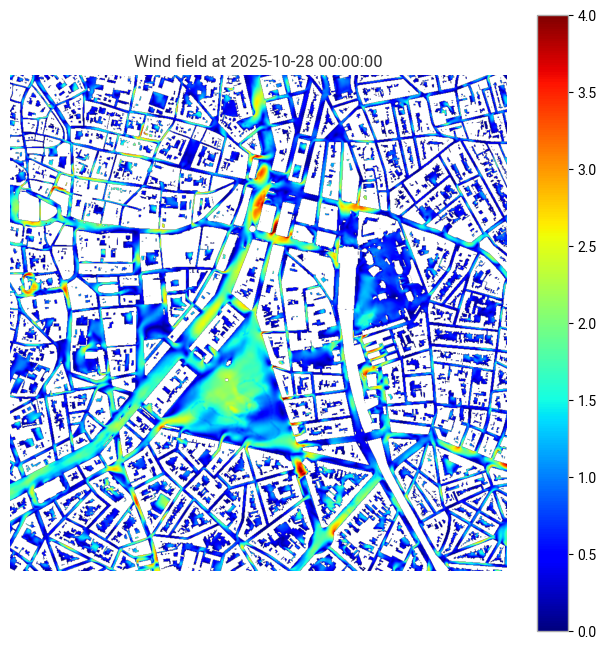

In [4]:


from matplotlib import animation
from IPython.display import HTML

times = sorted(wind_local.keys())

fig, ax = plt.subplots(figsize=(8,8))
all_values = np.concatenate([wind_local[t].ravel() for t in times])
vmin, vmax = np.percentile(all_values, [2, 98])  # robust color scale

im = ax.imshow(wind_local[times[0]], cmap='jet', animated=True, vmin=0, vmax=4)
cbar = fig.colorbar(im, ax=ax)
title = ax.set_title(f"Wind velocity [m/s] at {times[0]}")
ax.axis("off")

# Update function for animation
def update(frame):
    data = wind_local[times[frame]]
    im.set_array(data)
    title.set_text(f"Wind field at {times[frame]}")
    return [im, title]

# Build the animation
ani = animation.FuncAnimation(
    fig, update, frames=len(times), interval=800, blit=True
)

# Show in Jupyter
HTML(ani.to_jshtml())



In [ ]:
plt.close()